In [0]:
# import shutil 
# shutil.rmtree('data/catsvsdogs')

# Getting Data


The cats vs dogs dataset isn't available on keras library. You can download it from Kaggle however. Let's see how to do this by using the Kaggle API as it's going to be pretty useful to you if you want to join a competition or use other Kaggle datasets later on.

First, install the Kaggle API by uncommenting the following line and executing it, or by executing it in your terminal.

In [0]:
!pip install --upgrade kaggle scikit-plot

In [0]:
!pip install Pillow==5.3.0

This should print PIL version of 5.3.0 if not restart the runtime and run this cell again.

In [57]:
import PIL
print (PIL.PILLOW_VERSION)

5.3.0


In [0]:
#uncomment this once to upload kaggle.json

from google.colab import files
def getLocalFiles():
    _files = files.upload()
    if len(_files) >0:
       for k,v in _files.items():
         open(k,'wb').write(v)
getLocalFiles()

In [0]:
#uncomment and run this once when you upload kaggle.json

! mkdir -p ~/.kaggle/
! mv kaggle.json ~/.kaggle/

In [0]:
! kaggle competitions download -c dogs-vs-cats-redux-kernels-edition -p 'data/catsvsdogs'

In [0]:
path = 'data/catsvsdogs/'

! unzip -q -n {path}/train.zip -d {path}
! unzip -q -n {path}/test.zip -d {path}

train_path = 'data/catsvsdogs/train/'

In [0]:
# # Load the Drive helper and mount
# from google.colab import drive

# # This will prompt for authorization.
# drive.mount('/content/drive')

In [0]:
# # After executing the cell above, Drive
# # files will be present in "/content/drive/My Drive".
# !ls "/content/drive/My Drive/Colab Notebooks"

In [0]:
# !cp "/content/drive/My Drive/Colab Notebooks/finetune_2.h5" "finetune_2.h5"
# !cp "/content/drive/My Drive/Colab Notebooks/cat_dog.png" "cat_dog.png"

# Keras

In [0]:
import math
import os
import time
from PIL import Image
import tensorflow as tf
from tensorflow.python.framework import ops
import keras
from keras import backend as K
import skimage.io
import skimage.transform
import skimage.filters
from keras.models import load_model
from keras.preprocessing import image
import numpy as np
from keras.applications.vgg16 import preprocess_input, VGG16
import matplotlib.pyplot as plt
%matplotlib inline

K.set_learning_phase(0)

## Visualization of one example



Text(0.5,1,'dog (311, 316)')

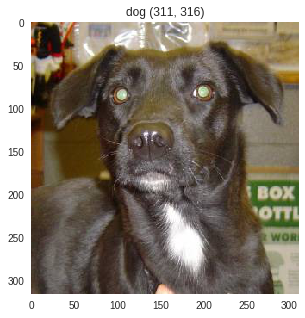

In [0]:
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(15, 5))

im = Image.open('data/catsvsdogs/train/dog.2818.jpg')
label = 'dog'
size = im.size
plt.grid(visible=False)
plt.imshow(im)
plt.title(f'{label} {size}')
 # print out the correct label for each image

In [0]:
def preprocess_image(img_path):
  img = image.load_img(img_path, target_size=(224, 224))
  x = image.img_to_array(img)
  x = np.expand_dims(x, axis=0)
  x = preprocess_input(x)
  return x

x = preprocess_image('data/catsvsdogs/train/dog.2818.jpg')

In [0]:
model = load_model('finetune_2.h5')
model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

In [0]:
for i, layer in enumerate(model.layers):
  print (i, layer.name)

0 input_2
1 block1_conv1
2 block1_conv2
3 block1_pool
4 block2_conv1
5 block2_conv2
6 block2_pool
7 block3_conv1
8 block3_conv2
9 block3_conv3
10 block3_pool
11 block4_conv1
12 block4_conv2
13 block4_conv3
14 block4_pool
15 block5_conv1
16 block5_conv2
17 block5_conv3
18 block5_pool
19 flatten_2
20 dense_10
21 dropout_7
22 dense_11
23 dropout_8
24 dense_12


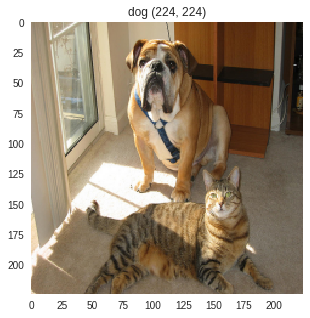

In [0]:
# plot the images in the batch, along with the corresponding labels
fig = plt.figure(figsize=(15, 5))

im = Image.open('cat_dog.png')
label = 'dog'
size = im.size
plt.grid(visible=False)
plt.imshow(im)
plt.title(f'{label} {size}')
 # print out the correct label for each image
  
x_new = preprocess_image('cat_dog.png')  

## Visualize weights

In [0]:
def normalize(image):
    image = image.astype(np.float32)
    return (image - image.min()) / (image.max() - image.min() + 1e-5)


def display_images(images, titles=None, cols=5, interpolation=None, cmap="Greys_r"):
  rows = math.ceil(len(images)/cols)
  height_ratio = 1.2 * (rows/cols) * (0.5 if type(images[0]) is not np.ndarray else 1)
  plt.figure(figsize=(15, 15 * height_ratio))
  titles = titles or [""] * len(images)
  
  i = 1
  for image, title in zip(images, titles):
      plt.subplot(rows, cols, i)
      plt.axis("off")
      # Is image a list? If so, merge them into one image.
      if type(image) is not np.ndarray:
          image = [normalize(g) for g in image]
          image = np.concatenate(image, axis=1)
      else:
          image = normalize(image)
      plt.title(title, fontsize=9)
      plt.imshow(image, cmap=cmap, interpolation=interpolation)
      i += 1

In [0]:
# Classify the image
predictions = model.predict(x)
print (predictions[0])

[0. 1.]


In [0]:
label_index = np.argmax(predictions)
print("label index: ", label_index)

label index:  1


(3, 3, 3, 64) -0.67140007 0.6085159


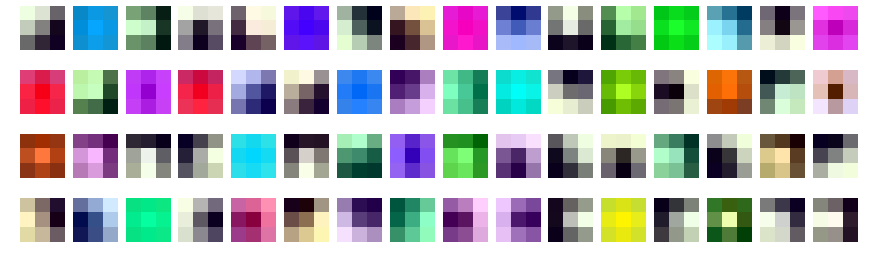

In [0]:
weights = model.get_layer('block1_conv1').get_weights()[0]
print (weights.shape, weights.min(), weights.max())
display_images([weights[:,:,::-1,i] for i in range(64)], cols=16, interpolation="None")

## Visualize Activations

Code borrowed from [https://github.com/waleedka/cnn-visualization/blob/master/cnn_visualization.ipynb](https://github.com/waleedka/cnn-visualization/blob/master/cnn_visualization.ipynb).

In [0]:
def read_layer(model, x, layer_name):
    """Return the activation values for the specifid layer"""
    # Create Keras function to read the output of a specific layer
    get_layer_output = K.function([model.layers[0].input], [model.get_layer(layer_name).output])
    outputs = get_layer_output([x])[0]
    return outputs[0]
    
def view_layer(model, x, layer_name, cols=5):
    outputs = read_layer(model, x, layer_name)
    display_images([outputs[:,:,i] for i in range(10)], cols=cols)

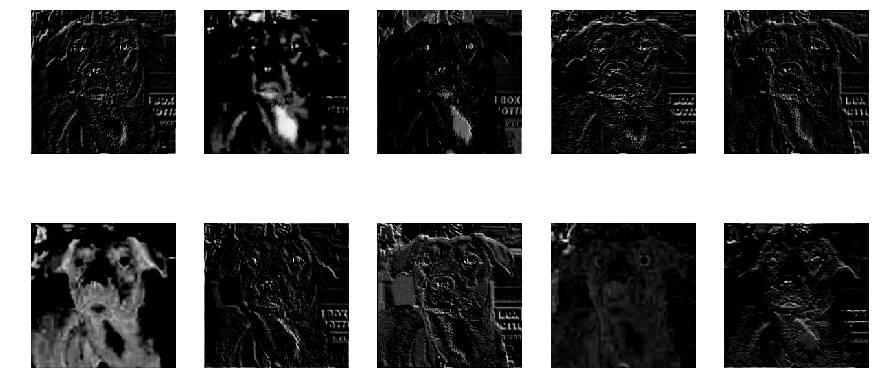

In [0]:
view_layer(model, x, "block1_conv1")

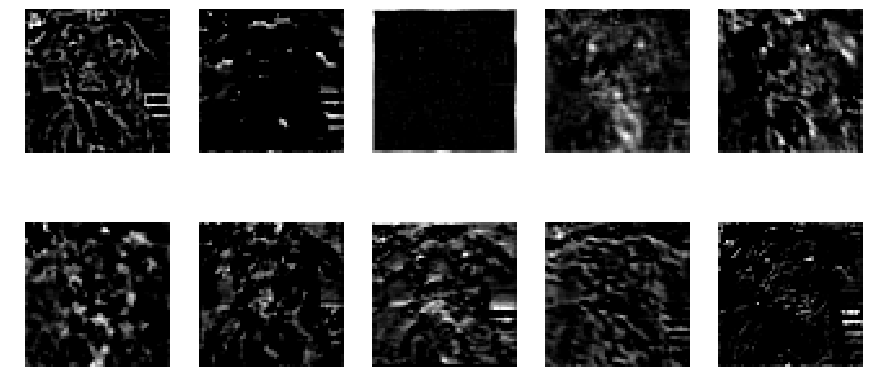

In [0]:
view_layer(model, x, "block3_conv1")

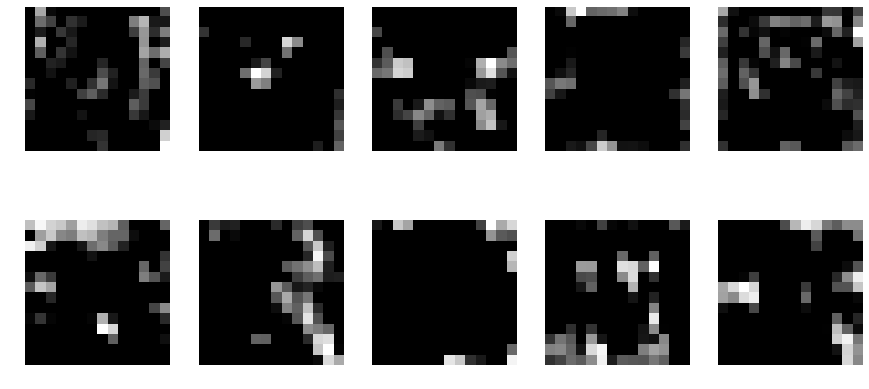

In [0]:
view_layer(model, x, "block5_conv1")

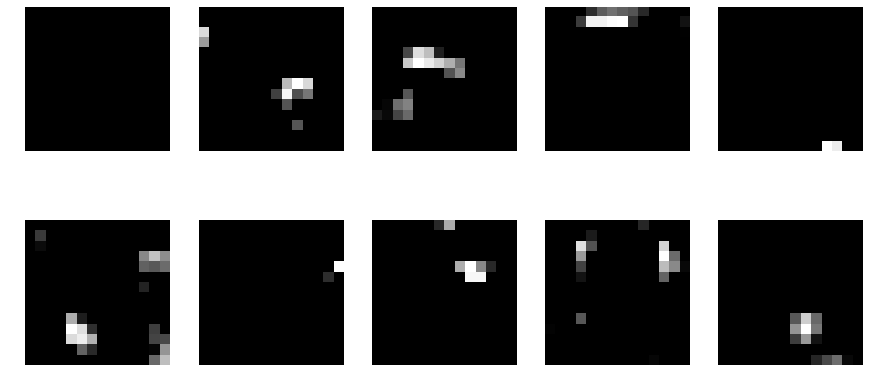

In [0]:
view_layer(model, x, "block5_conv3")

In [0]:
image = skimage.io.imread('data/catsvsdogs/train/dog.2818.jpg')

def apply_mask(image, mask):
  # Resize mask to match image size
  mask = skimage.transform.resize(normalize(mask), image.shape[:2])[:,:, None].copy()
  # Apply mask to image
  image_heatmap = image * mask
  display_images([image_heatmap], cols=2)

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


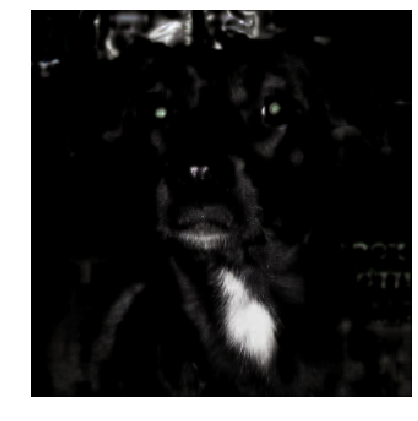

In [0]:
#edge detector

a = read_layer(model, x, "block1_conv1")
apply_mask(image, a[:, :, 1])

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


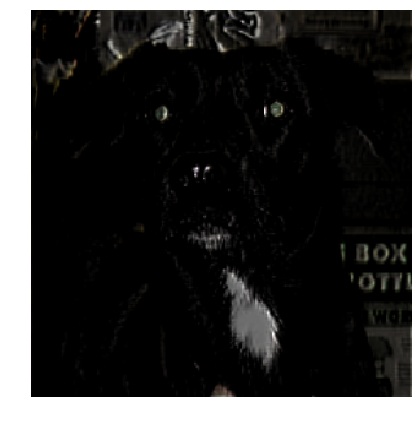

In [0]:
#edge detector

a = read_layer(model, x, "block1_conv1")
apply_mask(image, a[:, :, 2])

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


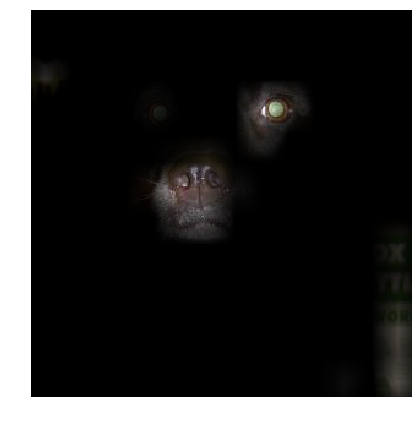

In [0]:
#eyes + nose detector

a = read_layer(model, x, "block5_conv1")
apply_mask(image, a[:, :, 1])

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


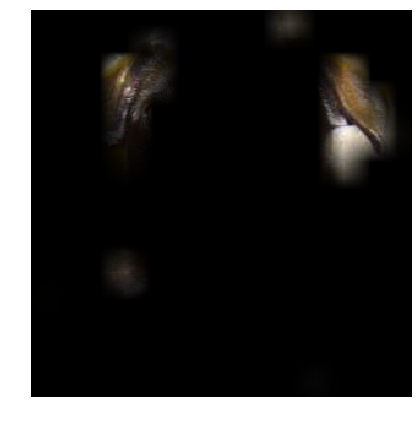

In [0]:
#ears detector

a = read_layer(model, x, "block5_conv3")
apply_mask(image, a[:, :, 8])

/usr/local/lib/python3.6/dist-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "


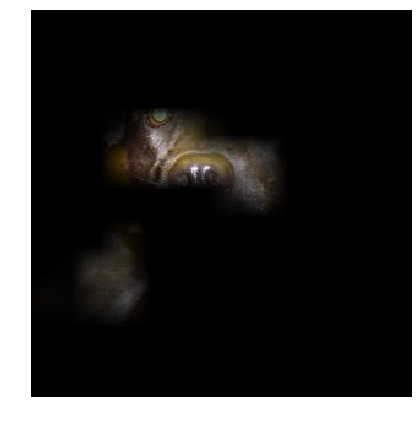

In [0]:
#whiskers + nose detector

a = read_layer(model, x, "block5_conv3")
apply_mask(image, a[:, :, 2])

##  Maximize the activation of the filters in different layers of the VGG16

Code borrowed from [keras blog](https://blog.keras.io/how-convolutional-neural-networks-see-the-world.html).

In [0]:

# dimensions of the generated pictures for each filter.
img_width = 128
img_height = 128

# util function to convert a tensor into a valid image
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + K.epsilon())
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    if K.image_data_format() == 'channels_first':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x


# this is the placeholder for the input images
input_img = model.input

# get the symbolic outputs of each "key" layer (we gave them unique names).
layer_dict = dict([(layer.name, layer) for layer in model.layers])

def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + K.epsilon())

def plot_layers(layer_name, num_filters=200, grids=8):
  kept_filters = []
  print ('Layer:', layer_name)
  for filter_index in range(num_filters):
      # we only scan through the first 200 filters,
      # but there are actually 512 of them
  #     print('Processing filter %d' % filter_index)
      start_time = time.time()

      # we build a loss function that maximizes the activation
      # of the nth filter of the layer considered
      layer_output = layer_dict[layer_name].output
      if K.image_data_format() == 'channels_first':
          loss = K.mean(layer_output[:, filter_index, :, :])
      else:
          loss = K.mean(layer_output[:, :, :, filter_index])

      # we compute the gradient of the input picture wrt this loss
      grads = K.gradients(loss, input_img)[0]

      # normalization trick: we normalize the gradient
      grads = normalize(grads)

      # this function returns the loss and grads given the input picture
      iterate = K.function([input_img], [loss, grads])

      # step size for gradient ascent
      step = 1.

      # we start from a gray image with some random noise
      if K.image_data_format() == 'channels_first':
          input_img_data = np.random.random((1, 3, img_width, img_height))
      else:
          input_img_data = np.random.random((1, img_width, img_height, 3))
      input_img_data = (input_img_data - 0.5) * 20 + 128

      # we run gradient ascent for 20 steps
      for i in range(20):
          loss_value, grads_value = iterate([input_img_data])
          input_img_data += grads_value * step

  #         print('Current loss value:', loss_value)
          if loss_value <= 0.:
              # some filters get stuck to 0, we can skip them
              break

      # decode the resulting input image
      if loss_value > 0:
          img = deprocess_image(input_img_data[0])
          kept_filters.append((img, loss_value))
      end_time = time.time()
  #     print('Filter %d processed in %ds' % (filter_index, end_time - start_time))

  # we will stich the best 64 filters on a 8 x 8 grid.
  n = grids

  # the filters that have the highest loss are assumed to be better-looking.
  # we will only keep the top 64 filters.
  kept_filters.sort(key=lambda x: x[1], reverse=True)
  kept_filters = kept_filters[:n * n]

  # build a black picture with enough space for
  # our 8 x 8 filters of size 128 x 128, with a 5px margin in between
  margin = 5
  width = n * img_width + (n - 1) * margin
  height = n * img_height + (n - 1) * margin
  stitched_filters = np.zeros((width, height, 3))

  # fill the picture with our saved filters
  for i in range(n):
      for j in range(n):
          img, loss = kept_filters[i * n + j]
          width_margin = (img_width + margin) * i
          height_margin = (img_height + margin) * j
          stitched_filters[
              width_margin: width_margin + img_width,
              height_margin: height_margin + img_height, :] = img

  plt.figure(figsize=(20, 10))
  plt.grid(visible=False)  
  # save the result to disk
  plt.imshow(stitched_filters)
  
  plt.show()

Layer: block1_conv1


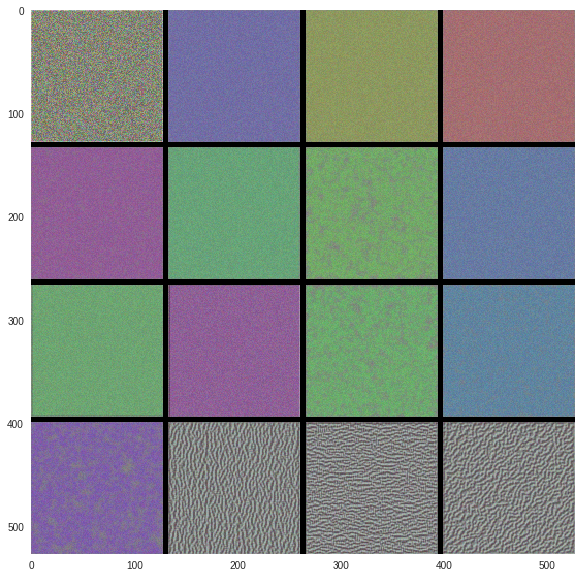

In [0]:
plot_layers('block1_conv1', 64, 4)

Layer: block2_conv1


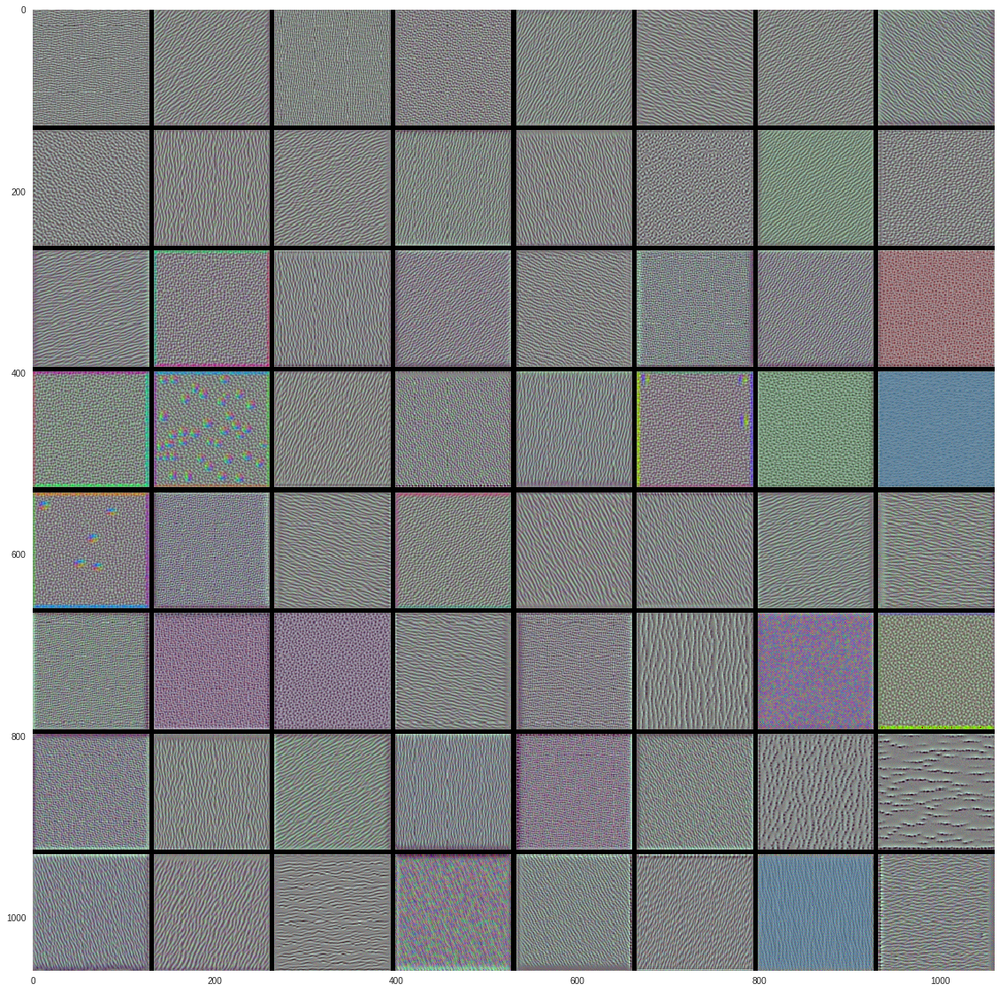

In [0]:
plot_layers('block2_conv1', 80, 8)

Layer: block3_conv1


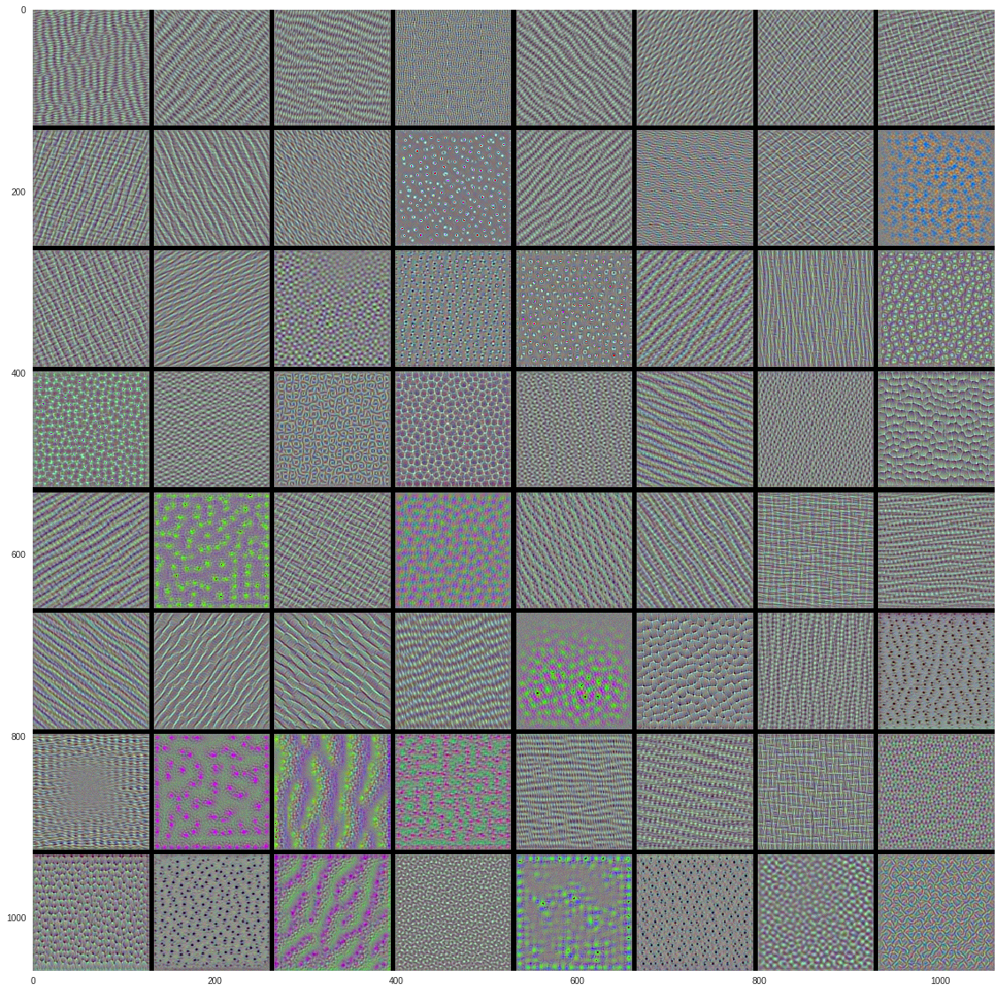

In [0]:
plot_layers('block3_conv1', 200, 8)

Layer: block4_conv1


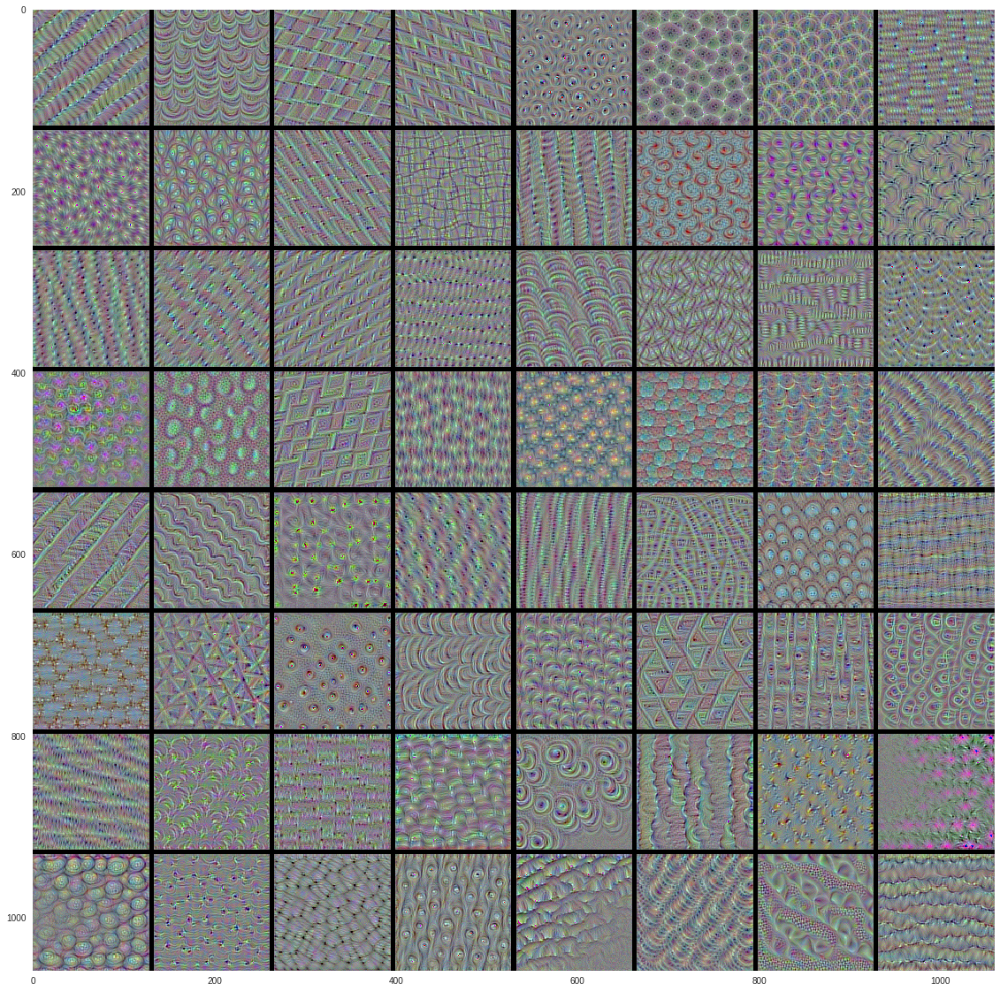

In [0]:
plot_layers('block4_conv1', 200, 8)

Layer: block5_conv1


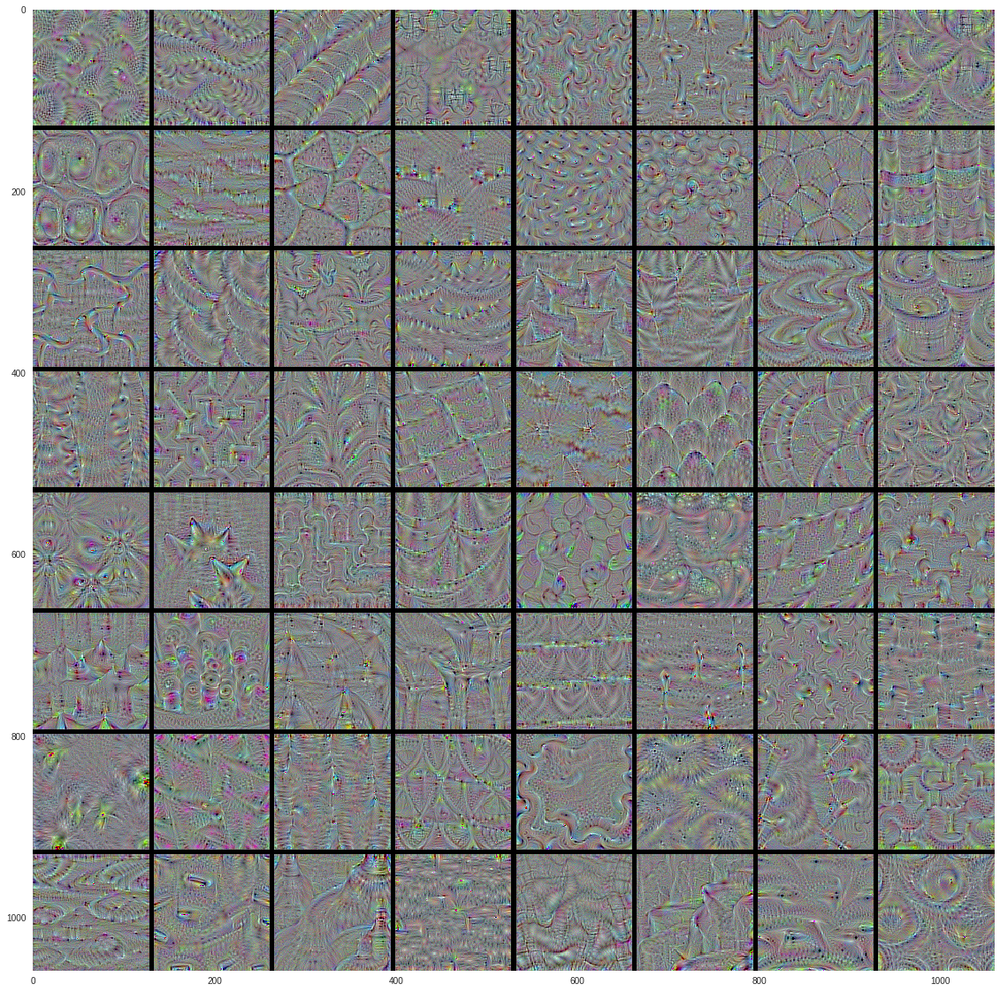

In [0]:
plot_layers('block5_conv1', 200, 8)

Layer: block5_conv3


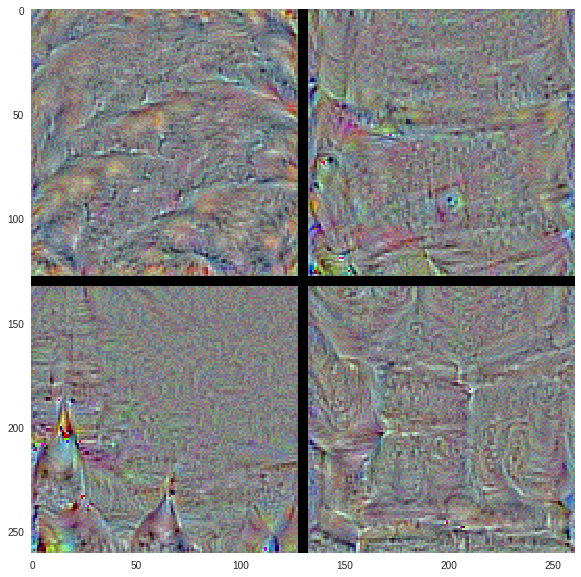

In [0]:
plot_layers('block5_conv3', 50, 2)

## Vanilla Backprop



To visualize activation over final dense layer outputs, we need to switch the softmax activation out for linear since gradient of output node will depend on all the other node activations. Doing this in keras is tricky.

If this swapping is not done, the results might be suboptimal. We will start by swapping out 'softmax' for 'linear' and compare what happens if we dont do this at the end.


In [0]:
from vis.utils import utils
from keras import activations

# Utility to search for layer index by name. 
# Alternatively we can specify this as -1 since it corresponds to the last layer.
layer_idx = utils.find_layer_idx(model, 'dense_12')

# Swap softmax with linear
model.layers[layer_idx].activation = activations.linear
model = utils.apply_modifications(model)

In [0]:
def build_backprop(model, loss):
    # Gradient of the input image with respect to the loss function
    gradients = K.gradients(loss, model.input)[0]
    # Normalize the gradients
    gradients /= (K.sqrt(K.mean(K.square(gradients))) + 1e-5)
    # Keras function to calculate the gradients and loss
    return K.function([model.input], [loss, gradients])
  
def normalize(x):
    """Utility function to normalize a tensor by its L2 norm"""
    return (x + 1e-10) / (K.sqrt(K.mean(K.square(x))) + 1e-10)
  
# util function to convert a tensor into a valid image
def deprocess_image(x):
    # normalize tensor: center on 0., ensure std is 0.1
    x -= x.mean()
    x /= (x.std() + K.epsilon())
    x *= 0.1

    # clip to [0, 1]
    x += 0.5
    x = np.clip(x, 0, 1)

    # convert to RGB array
    x *= 255
    if K.image_data_format() == 'channels_first':
        x = x.transpose((1, 2, 0))
    x = np.clip(x, 0, 255).astype('uint8')
    return x

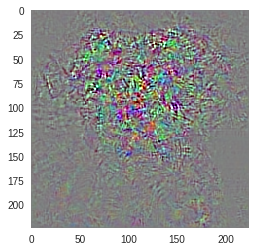

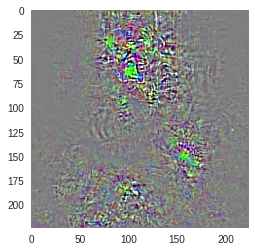

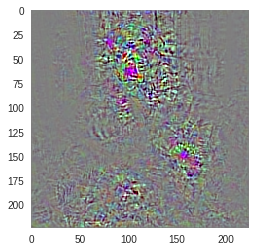

In [0]:
# Loss function that optimizes dog class
loss_function = K.mean(model.output[:, 1])
# Backprop function
backprop = build_backprop(model, loss_function)

# Calculate gradients on the input image
loss, grads = backprop([x])
plt.grid(visible=False)
plt.imshow(deprocess_image(grads[0]))
plt.show()


# Loss function that optimizes cat class
loss_function = K.mean(model.output[:, 0])
# Backprop function
backprop = build_backprop(model, loss_function)

# Calculate gradients on the input image
loss, grads = backprop([x_new])
plt.grid(visible=False)
plt.imshow(deprocess_image(grads[0]))
plt.show()


# Loss function that optimizes dog class
loss_function = K.mean(model.output[:, 1])
# Backprop function
backprop = build_backprop(model, loss_function)

# Calculate gradients on the input image
loss, grads = backprop([x_new])
plt.grid(visible=False)
plt.imshow(deprocess_image(grads[0]))
plt.show()

## Guided Backprop

Code borrowed from [https://github.com/eclique/keras-gradcam](https://github.com/eclique/keras-gradcam).

In [0]:
def build_guided_model():
    """Function returning modified model.
    
    Changes gradient function for all ReLu activations
    according to Guided Backpropagation.
    """
    if "GuidedBackProp" not in ops._gradient_registry._registry:
        @ops.RegisterGradient("GuidedBackProp")
        def _GuidedBackProp(op, grad):
            dtype = op.inputs[0].dtype
            return grad * tf.cast(grad > 0., dtype) * \
                   tf.cast(op.inputs[0] > 0., dtype)

    g = tf.get_default_graph()
    with g.gradient_override_map({'Relu': 'GuidedBackProp'}):
        new_model = model
    return new_model
  
  
guided_model = build_guided_model()

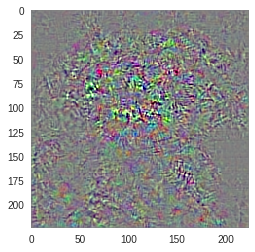

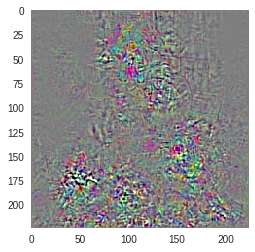

In [0]:
def guided_backprop(input_model, images, layer_name):
    """Guided Backpropagation method for visualizing input saliency."""
    input_imgs = input_model.input
    layer_output = input_model.get_layer(layer_name).output
    grads = K.gradients(layer_output, input_imgs)[0]
    backprop_fn = K.function([input_imgs], [grads])
    grads_val = backprop_fn([images])[0]
    return grads_val
  
  
gb_dog = guided_backprop(guided_model, x, 'block5_conv3')
plt.grid(visible=False)
plt.imshow(np.flip(deprocess_image(gb_dog[0]), -1))
plt.show()

gb_newcatdog = guided_backprop(guided_model, x_new, 'block5_conv3')
plt.grid(visible=False)
plt.imshow(np.flip(deprocess_image(gb_newcatdog[0]), -1))
plt.show()

## Grad CAM

In [0]:
import cv2

def normalize(x):
    # utility function to normalize a tensor by its L2 norm
    return x / (K.sqrt(K.mean(K.square(x))) + K.epsilon())

H, W = 224, 224

In [0]:
def grad_cam(input_model, image, cls, layer_name):
    """GradCAM method for visualizing input saliency."""
    y_c = input_model.output[:, cls]
    conv_output = input_model.get_layer(layer_name).output
    grads = K.gradients(y_c, conv_output)[0]
    # Normalize if necessary
    grads = normalize(grads)
    gradient_function = K.function([input_model.input], [conv_output, grads])

    output, grads_val = gradient_function([image])
    output, grads_val = output[0, :], grads_val[0, :, :, :]

    weights = np.mean(grads_val, axis=(0, 1))
    
    cam = np.dot(output, weights)
    
    
    # Process CAM
    cam = cv2.resize(cam, (H, W), cv2.INTER_LINEAR)
    cam = np.maximum(cam, 0)
    cam = cam / cam.max()
    return cam

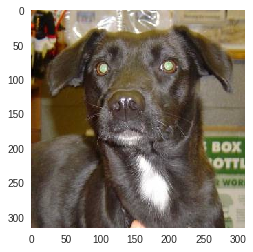

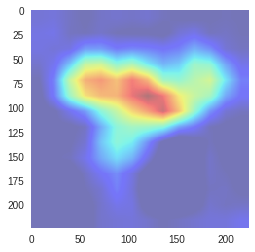

In [0]:
gradcam_dog = grad_cam(model, x, cls=1, layer_name='block5_conv3')

img = cv2.imread('data/catsvsdogs/train/dog.2818.jpg')
img2 = img[:,:,::-1]
plt.grid(visible=False)
plt.imshow(img2)
plt.show()
plt.grid(visible=False)
plt.imshow(gradcam_dog, cmap='jet', alpha=0.5)
plt.show()

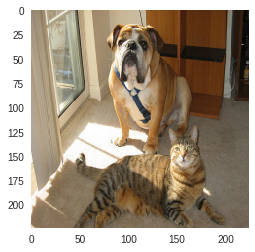

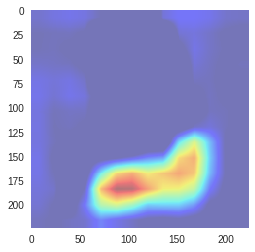

In [0]:
gradcam_newcat = grad_cam(model, x_new, cls=0, layer_name='block5_conv3')

img = cv2.imread('cat_dog.png')
img2 = img[:,:,::-1]
plt.grid(visible=False)
plt.imshow(img2)
plt.show()
plt.grid(visible=False)
plt.imshow(gradcam_newcat, cmap='jet', alpha=0.5)
plt.show()

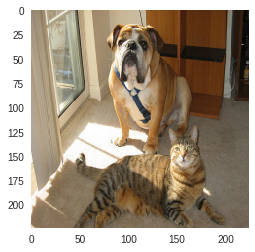

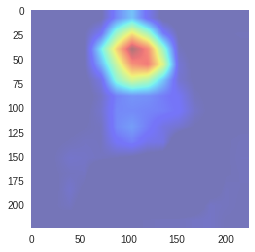

In [0]:
gradcam_newdog = grad_cam(model, x_new, cls=1, layer_name='block5_conv3')

img = cv2.imread('cat_dog.png')
img2 = img[:,:,::-1]
plt.grid(visible=False)
plt.imshow(img2)
plt.show()
plt.grid(visible=False)
plt.imshow(gradcam_newdog, cmap='jet', alpha=0.5)
plt.show()

## Guided Grad CAM

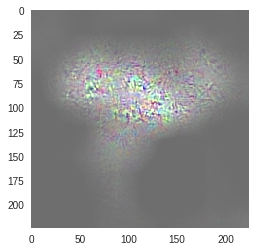

In [0]:
guided_gradcam = gb_dog * gradcam_dog[..., np.newaxis]
plt.grid(visible=False)
plt.imshow(np.flip(deprocess_image(guided_gradcam[0]), -1))
plt.show()

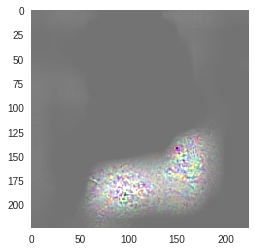

In [0]:
guided_gradcam = gb_newcatdog * gradcam_newcat[..., np.newaxis]
plt.grid(visible=False)
plt.imshow(np.flip(deprocess_image(guided_gradcam[0]), -1))
plt.show()

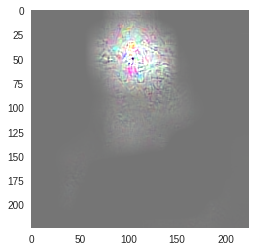

In [0]:
guided_gradcam = gb_newcatdog * gradcam_newdog[..., np.newaxis]
plt.grid(visible=False)
plt.imshow(np.flip(deprocess_image(guided_gradcam[0]), -1))
plt.show()

## Class Maximazation

In [0]:
# Swap linear back with softmax
model.layers[layer_idx].activation = activations.softmax
model = utils.apply_modifications(model)

# Loss function that optimizes dog class
loss_function = K.mean(model.output[:, 1])

# Backprop function
backprop = build_backprop(model, loss_function)

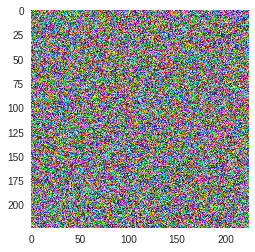

In [0]:
# Start with a random image
random_image = np.random.random((224, 224, 3))
plt.grid(visible=False)
plt.imshow(random_image)

Loss: 0.40677634
Loss: 0.99999976
Loss: 0.99999976
Loss: 0.99999976
Loss: 0.99999976
Loss: 0.99999976


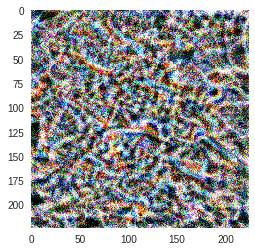

In [0]:
# Iteratively apply gradient ascent
for i in range(60):
    loss, grads = backprop([random_image[None]])
    
    # Multiply gradients by the learning rate and add to the image
    # Optionally, apply a gaussian filter to the gradients to smooth
    # out the generated image. This gives better results.
    # The first line, which is commented out, is the native method
    # and the following line uses the filter. Try with both to
    # see the difference.
    #
    #random_image[None] += grads * .1
    random_image[None] += skimage.filters.gaussian(np.clip(grads, -1, 1), 2) 

    # Print loss value
    if i % 10 == 0:
        print('Loss:', loss)

plt.grid(visible=False)  
plt.imshow(np.clip(random_image, 0, 1))

In [0]:
# Classify the image
predictions = model.predict(random_image[None])
predictions

array([[1.7701734e-07, 9.9999988e-01]], dtype=float32)

## t-SNE Visualization

Here we will use last second layer to visualize 100 random images from training set in an embedding projector on [projector.tensorflow.org](projector.tensorflow.org).

In [0]:
import random
np.random.seed(42)
images_paths = random.sample(os.listdir('data/catsvsdogs/train/'), 100)
images_paths = ['data/catsvsdogs/train/'+x for x in images_paths]
labels = [x.split('/')[3].split('.')[0] for x in images_paths]
print (images_paths[:5], len(images_paths))
print (labels[:5], len(labels))

['data/catsvsdogs/train/cat.4205.jpg', 'data/catsvsdogs/train/dog.10096.jpg', 'data/catsvsdogs/train/dog.1741.jpg', 'data/catsvsdogs/train/cat.10213.jpg', 'data/catsvsdogs/train/cat.836.jpg'] 100
['cat', 'dog', 'dog', 'cat', 'cat'] 100


In [0]:
# model = load_model('finetune_2.h5')
from keras.models import Model
from keras.preprocessing import image

In [0]:
new_model = Model(model.input, model.get_layer('dense_11').output)
new_model.summary()

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

In [0]:
def images_to_sprite(data):
    """
    Creates the sprite image along with any necessary padding
    Source : https://github.com/tensorflow/tensorflow/issues/6322
    Args:
      data: NxHxW[x3] tensor containing the images.
    Returns:
      data: Properly shaped HxWx3 image with any necessary padding.
    """
    if len(data.shape) == 3:
        data = np.tile(data[...,np.newaxis], (1,1,1,3))
    data = data.astype(np.float32)
    min = np.min(data.reshape((data.shape[0], -1)), axis=1)
    data = (data.transpose(1,2,3,0) - min).transpose(3,0,1,2)
    max = np.max(data.reshape((data.shape[0], -1)), axis=1)
    data = (data.transpose(1,2,3,0) / max).transpose(3,0,1,2)
    
    n = int(np.ceil(np.sqrt(data.shape[0])))
    padding = ((0, n ** 2 - data.shape[0]), (0, 0),
            (0, 0)) + ((0, 0),) * (data.ndim - 3)
    data = np.pad(data, padding, mode='constant',
            constant_values=0)
    # Tile the individual thumbnails into an image.
    data = data.reshape((n, n) + data.shape[1:]).transpose((0, 2, 1, 3)
            + tuple(range(4, data.ndim + 1)))
    data = data.reshape((n * data.shape[1], n * data.shape[3]) + data.shape[4:])
    data = (data * 255).astype(np.uint8)
    return data


def populate_img_arr(images_paths, size=(100,100),should_preprocess= False):
    """
    Get an array of images for a list of image paths
    Args:
        size: the size of image , in pixels 
        should_preprocess: if the images should be processed (according to InceptionV3 requirements)
    Returns:
        arr: An array of the loaded images
    """
    arr = []
    for i,img_path in enumerate(images_paths):
        img = image.load_img(img_path, target_size=size)
        x = image.img_to_array(img)
        arr.append(x)
    arr = np.array(arr)
    if should_preprocess:
        arr = preprocess_input(arr)
    return arr

In [0]:
img_arr = populate_img_arr(images_paths,size=(224, 224), should_preprocess=True)
preds = new_model.predict(img_arr,batch_size=50)
# preds.tofile("tensor.bytes")
#del img_arr,preds

In [0]:
raw_imgs = populate_img_arr(images_paths ,size=(100,100),should_preprocess=False)
sprite = Image.fromarray(images_to_sprite(raw_imgs).astype(np.uint8))
# sprite.save('sprites.png')
# del raw_imgs

In [0]:
with open('labels.tsv','w') as f:
  for label in labels:
    f.write("%s\n" % (label))

Download all 3 files created above: 

`tensor.bytes`, `sprites.png` and `labels.tsv`

Head to [projector.tensorflow.org](https://projector.tensorflow.org) and follow the instructions as mentioned after clicking "Publish" button on left-side.

In [0]:
import pandas as pd
import seaborn as sns
from sklearn.manifold import TSNE

l = [0 if x == 'cat' else 1 for x in labels ]; l[:5]
l = np.array(l)

In [0]:
preds_trans = TSNE(n_components=2, perplexity=25).fit_transform(preds)

In [0]:
preds_df = pd.DataFrame(np.concatenate((preds_trans, l[:, None]), axis=1), columns=['x','y','labels'])

In [0]:
preds_df.head()

,x,y,labels
0,-4.284378,24.364525,0.0
1,25.696053,-41.844444,1.0
2,14.123128,-16.704441,1.0
3,-4.376058,9.303142,0.0
4,-16.433620,35.883923,0.0


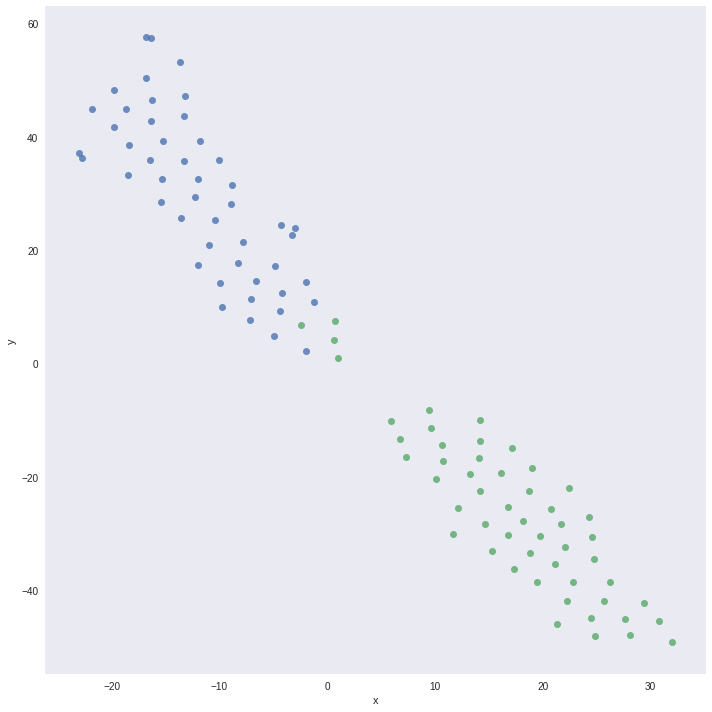

In [0]:
sns.lmplot('x', 'y', data=preds_df, hue='labels', fit_reg=False, legend=False, size=10)
plt.grid(visible=False)

## Deep Dream

Code borrowed from [https://github.com/giuseppebonaccorso/keras_deepdream/blob/master/Keras%20Deepdream.ipynb](https://github.com/giuseppebonaccorso/keras_deepdream/blob/master/Keras%20Deepdream.ipynb).

In [0]:
np.random.seed(1000)
import warnings
from keras.applications.imagenet_utils import preprocess_input
from scipy.optimize import minimize
from keras.applications.vgg19 import VGG19
from skimage import img_as_float, img_as_ubyte
from skimage.io import imread, imsave
from skimage.transform import pyramid_gaussian, rescale

In [0]:
!cp "/content/drive/My Drive/Colab Notebooks/cinque_terre.jpg" "cinque_terre.jpg"

In [0]:
def show_image(image):
    fig, ax = plt.subplots(figsize=(18, 15))
    ax.imshow(image)
    ax.get_xaxis().set_visible(False)
    ax.get_yaxis().set_visible(False)
    
def preprocess_image(image):
    return preprocess_input(np.expand_dims(image.astype(K.floatx()), 0))
    
def postprocess_image(image):
    image[:, :, :, 0] += 103.939
    image[:, :, :, 1] += 116.779
    image[:, :, :, 2] += 123.68
    return np.clip(image[:, :, :, ::-1], 0, 255).astype('uint8')[0]

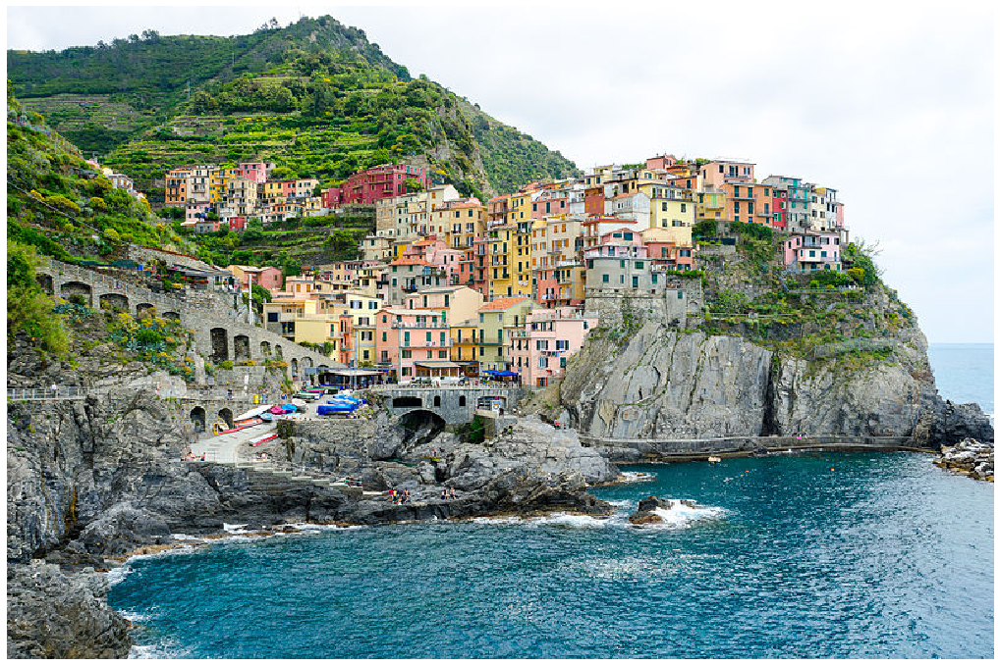

In [0]:
original_image = 'cinque_terre.jpg'
final_image = 'cinque_terre_dream.jpg'

original_image_array = imread(original_image)
show_image(original_image_array)

In [0]:
#Prepare the Gaussian Pyramid

# Ignore some warnings from scikit-image
warnings.simplefilter("ignore")

# Create gaussian pyramid
original_image_as_float = img_as_float(original_image_array)
pyramid = list(pyramid_gaussian(original_image_as_float, downscale=2, max_layer=5))

# Convert each image to unsigned byte (0-255)
for i, image in enumerate(pyramid):
    pyramid[i] = img_as_ubyte(pyramid[i])
    print('Image {}) Size: {}'.format(i, pyramid[i].shape))

Image 0) Size: (530, 800, 3)
Image 1) Size: (265, 400, 3)
Image 2) Size: (133, 200, 3)
Image 3) Size: (67, 100, 3)
Image 4) Size: (34, 50, 3)
Image 5) Size: (17, 25, 3)


In [0]:
# Initialize model
model = load_model('finetune_2.h5')
convnet = model
convnet.summary()
# convnet = VGG19(include_top=False, weights='imagenet')

_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_2 (InputLayer)         (None, 224, 224, 3)       0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 224, 224, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 224, 224, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 112, 112, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 112, 112, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 112, 112, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 56, 56, 128)       0         
__________

In [0]:
#loss and gradient functions
layers = {
    'block5_conv1': 0.001,
    'block5_conv2': 0.001,
#     'block5_conv3': 0.002
    #'block5_conv4': 0.005,
}

image_l2_weight = 0.005

In [0]:
loss_tensor = 0.0

for layer, weight in layers.items():
    loss_tensor += (-weight * K.sum(K.square(convnet.get_layer(layer).output)))
    
loss_tensor += image_l2_weight * K.sum(K.square(convnet.layers[0].input))

_loss_function = K.function(inputs=[convnet.layers[0].input], outputs=[loss_tensor])

In [0]:
loss_gradient = K.gradients(loss=loss_tensor, variables=[convnet.layers[0].input])
_gradient_function = K.function(inputs=[convnet.layers[0].input], outputs=loss_gradient)

In [0]:
def loss(x, shape):
    return _loss_function([x.reshape(shape)])[0]

def gradient(x, shape):
    return _gradient_function([x.reshape(shape)])[0].flatten().astype(np.float64)


In [0]:
def process_image(image, iterations=2):
    # Create bounds
    bounds = np.ndarray(shape=(image.flatten().shape[0], 2))
    bounds[:, 0] = -128.0
    bounds[:, 1] = 128.0

    # Initial value
    x0 = image.flatten()

    # Perform optimization
    result = minimize(fun=loss, 
                      x0=x0, 
                      args=list(image.shape), 
                      jac=gradient, 
                      method='L-BFGS-B', 
                      bounds=bounds, 
                      options={'maxiter': iterations})
    
    return postprocess_image(np.copy(result.x.reshape(image.shape)))

In [0]:
#processing loop

processed_image = None

for i, image in enumerate(pyramid[::-1]):
    print('Processing pyramid image: {} {}'.format(len(pyramid)-i, image.shape))
    
    if processed_image is None:
        processed_image = process_image(preprocess_image(image))
    else:
        h, w = image.shape[0:2]
        ph, pw = processed_image.shape[0:2]
        rescaled_image = rescale(processed_image, order=5, scale=(float(h)/float(ph), float(w)/float(pw)))
        combined_image = img_as_ubyte((1.2*img_as_float(image) + 0.8*rescaled_image) / 2.0)
        processed_image = process_image(preprocess_image(combined_image), iterations=5)

Processing pyramid image: 6 (17, 25, 3)
Processing pyramid image: 5 (34, 50, 3)
Processing pyramid image: 4 (67, 100, 3)
Processing pyramid image: 3 (133, 200, 3)
Processing pyramid image: 2 (265, 400, 3)
Processing pyramid image: 1 (530, 800, 3)


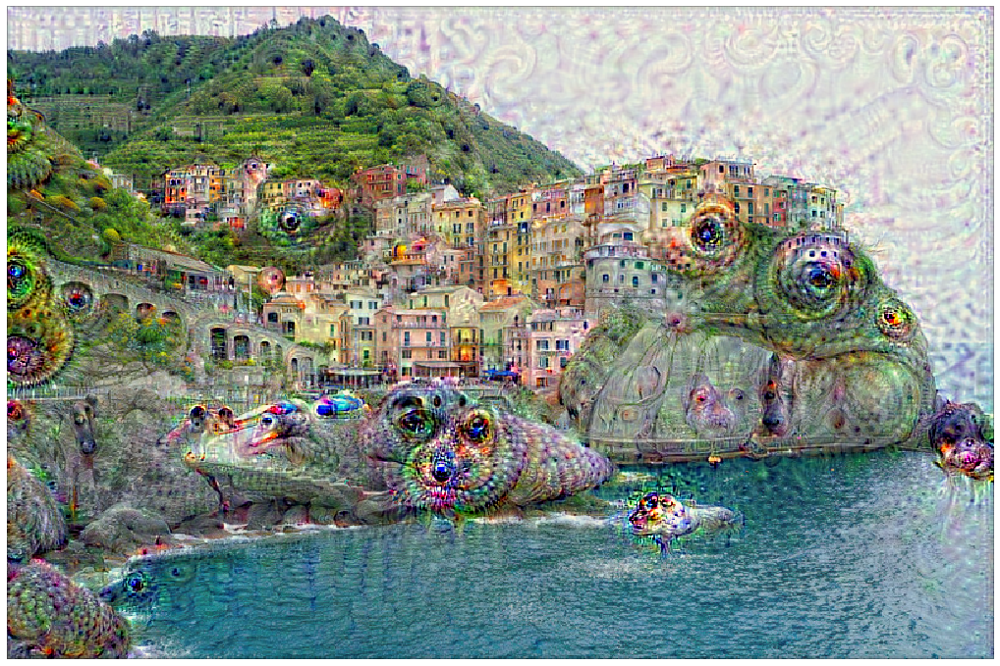

In [0]:
show_image(processed_image)